# Isochronen in Dresden

Für die Erklärung bitte [hier gucken:](beispiel-dominos-freiberg)


## Scenario Beschreibungen:
- Für eine Detailierte Beschreibung bitte in [beschreibung-szenarien](beschreibung-szenarien) gucken.
- tl;dr
    - Small: Nur Sidewalks
    - Medium: Alles außer Große Straßen
    - Medium-restricted: Sidewalks und Radwege
    - Large: Nur Straßen keine Fuß und Radwege
    - Optimal: Alles


In [87]:
import folium
import geopandas as gpd
import matplotlib.pyplot as plt
import networkx as nx
import numpy as np
import osmnx as ox
import pyproj # we need this for jupyter-book to build right
from configobj import ConfigObj
# from descartes import PolygonPatch
from pathlib import Path
from helpers import configreader as cfr
from helpers import osmhelper as oh
from helpers import ready4robots as r4r
from numpy import asarray, concatenate, ones
from pyproj import Proj, transform
from shapely.geometry import LineString, MultiPolygon, Point, Polygon
from shapely.geometry import mapping

In [88]:
import warnings
warnings.filterwarnings('ignore')
ox.__version__

'1.9.4'

In [89]:
cfg = ConfigObj("notebook.ini")
place = "Dresden, Sachsen"
trip_times = [5, 10, 15, 20, 25, 30]  # in minutes
travel_speed = 3.6  # in km/h

ox.settings.useful_tags_way += cfr.get_relevant_tags(cfg)
# ox.config(log_console=True, use_cache=True)

## Alle Straßen
### Download and prep the street network

In [90]:
# download the street network
# G_84 = r4r.get_graph(place)

latitude = 51.047993772661066 
longitude = 13.74043214154367
G_84 = ox.graph_from_point((latitude, longitude),
                           dist=1500, network_type='all')

In [91]:
# find the centermost node and then project the graph to UTM
# gdf_nodes = ox.graph_to_gdfs(G_84, edges=False)
# x, y = gdf_nodes['geometry'].unary_union.centroid.xy
# center_node = ox.nearest_nodes(G_84, x[0], y[0])
# center_node = ox.nearest_nodes(G_84, 13.3447448, 50.9162500)
center_node = ox.nearest_nodes(
    G_84, longitude, latitude)  # Dresden, Rathaus
# center_node = 3930896811
G = ox.project_graph(G_84)

In [92]:
center_node

403203636

In [93]:
# add an edge attribute for time in minutes required to traverse each edge
meters_per_minute = travel_speed * 1000 / 60  # km per hour to m per minute
for u, v, k, data in G.edges(data=True, keys=True):
    data['time'] = data['length'] / meters_per_minute

In [94]:
# get one color for each isochrone
iso_colors = ox.plot.get_colors(
    n=len(trip_times), cmap='plasma', start=0)

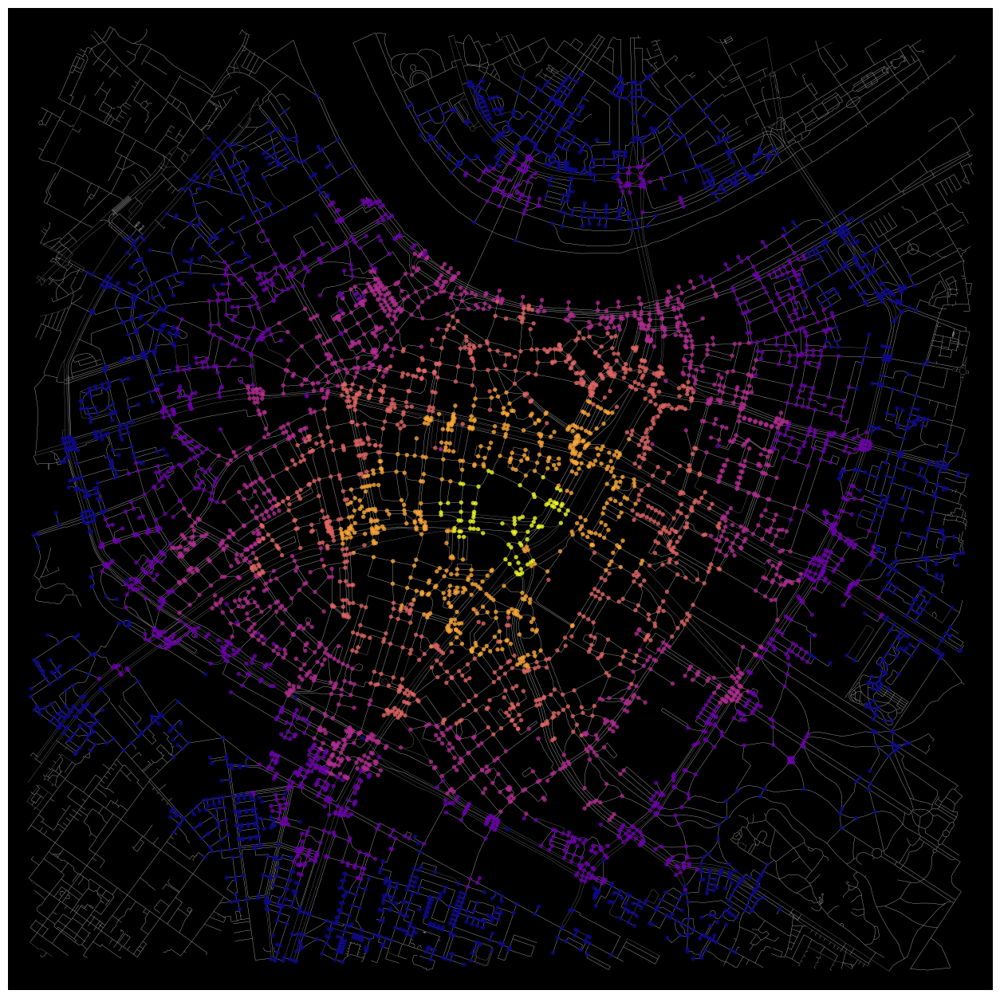

In [95]:
# color the nodes according to isochrone then plot the street network
node_colors = {}
for trip_time, color in zip(sorted(trip_times, reverse=True), iso_colors):
    subgraph = nx.ego_graph(G, center_node, radius=trip_time, distance='time')
    for node in subgraph.nodes():
        node_colors[node] = color
nc = [node_colors[node] if node in node_colors else 'none' for node in G.nodes()]
ns = [15 if node in node_colors else 0 for node in G.nodes()]
fig, ax = ox.plot_graph(G, node_color=nc, node_size=ns, node_alpha=0.8, node_zorder=2,
                        bgcolor='k', edge_linewidth=0.2, edge_color='#999999', figsize=(16, 16))

### Plot the time-distances as isochrones
How far can you walk in 5, 10, 15, 20, and 25 minutes from the origin node? We'll use a convex hull, which isn't perfectly accurate. A concave hull would be better, but shapely doesn't offer that.

In [96]:
# make the isochrone polygons
isochrone_polys = []
for trip_time in sorted(trip_times, reverse=True):
    subgraph = nx.ego_graph(G, center_node, radius=trip_time, distance='time')
    node_points = [Point((data['x'], data['y']))
                   for node, data in subgraph.nodes(data=True)]
    bounding_poly = gpd.GeoSeries(node_points).unary_union.convex_hull
    isochrone_polys.append(bounding_poly)

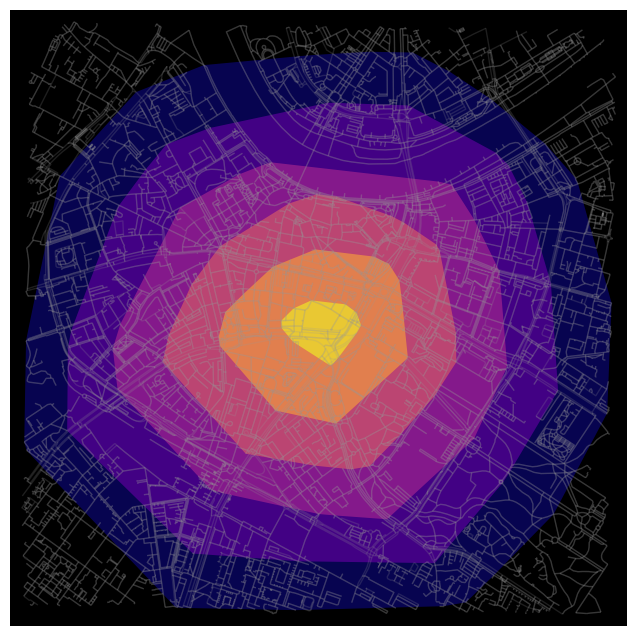

In [97]:
# First, plot the network
fig, ax = ox.plot_graph(G, show=False, close=False,
                        edge_color='#999999', edge_alpha=0.2, node_size=0, bgcolor='k')

# Now, plot each isochrone polygon
for polygon, color in zip(isochrone_polys, iso_colors):
    # Extract the exterior coordinates of the polygon
    x, y = polygon.exterior.xy
    ax.fill(x, y, fc=color, ec='none', alpha=0.6, zorder=-1)

    # If there are interiors (holes) in the polygon, plot them too
    for interior in polygon.interiors:
        x, y = interior.xy
        # Fill the hole with the background color (in this case, black)
        ax.fill(x, y, fc='k', ec='none', alpha=0.6)

plt.show()

(faithful-isochrones-dresden)=
### Or, plot isochrones as buffers to get more faithful isochrones than convex hulls can offer


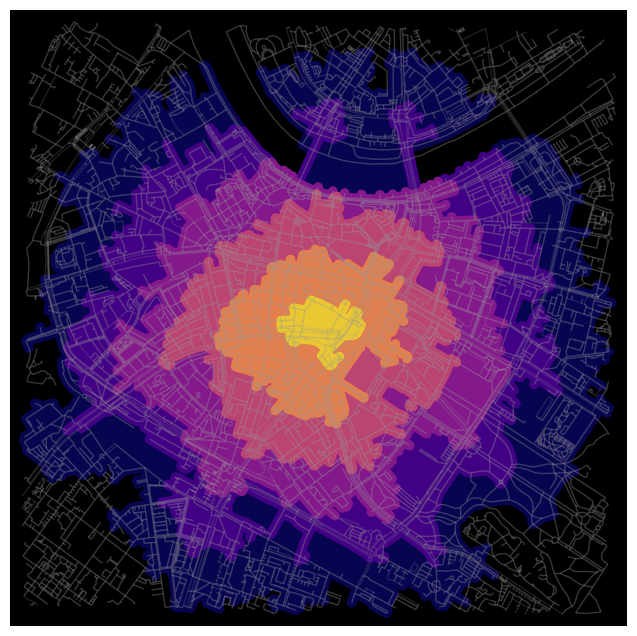

In [98]:
def make_iso_polys(G, edge_buff=25, node_buff=50, infill=False):
    isochrone_polys = []
    for trip_time in sorted(trip_times, reverse=True):
        subgraph = nx.ego_graph(
            G, center_node, radius=trip_time, distance='time')

        node_points = [Point((data['x'], data['y']))
                       for node, data in subgraph.nodes(data=True)]
        nodes_gdf = gpd.GeoDataFrame(
            {'id': subgraph.nodes()}, geometry=node_points)
        nodes_gdf = nodes_gdf.set_index('id')

        edge_lines = []
        for n_fr, n_to in subgraph.edges():
            f = nodes_gdf.loc[n_fr].geometry
            t = nodes_gdf.loc[n_to].geometry
            edge_data = G.get_edge_data(n_fr, n_to).get(0, None)
            if edge_data is None:
                continue
            edge_lookup = edge_data.get(
                'geometry',  LineString([f, t]))
            edge_lines.append(edge_lookup)

        n = nodes_gdf.buffer(node_buff).geometry
        e = gpd.GeoSeries(edge_lines).buffer(edge_buff).geometry
        all_gs = list(n) + list(e)
        new_iso = gpd.GeoSeries(all_gs).unary_union

        # try to fill in surrounded areas so shapes will appear solid and blocks without white space inside them
        if infill:
            new_iso = Polygon(new_iso.exterior)
        isochrone_polys.append(new_iso)
    return isochrone_polys


# Plotting section
isochrone_polys = make_iso_polys(G, edge_buff=25, node_buff=0, infill=True)
fig, ax = ox.plot_graph(G, show=False, close=False,
                        edge_color='#999999', edge_alpha=0.2, node_size=0, bgcolor='k')

# Plot each isochrone polygon
for polygon, color in zip(isochrone_polys, iso_colors):
    # Extract the exterior coordinates of the polygon
    x, y = polygon.exterior.xy
    ax.fill(x, y, fc=color, ec='none', alpha=0.6, zorder=-1)

    # If there are interiors (holes) in the polygon, plot them too
    for interior in polygon.interiors:
        x, y = interior.xy
        # Fill the hole with the background color (in this case, black)
        ax.fill(x, y, fc='k', ec='none', alpha=0.6)

plt.show()

In [99]:
def make_iso_polys_time(G, edge_buff=25, node_buff=50, infill=False, time_window=15):
    # Assume trip_times is a list of time values (in minutes) you're interested in
    trip_times = [time_window]

    isochrone_polys = []

    for trip_time in trip_times:
        subgraph = nx.ego_graph(
            G, center_node, radius=trip_time, distance='time')

        node_points = [Point((data['x'], data['y']))
                       for node, data in subgraph.nodes(data=True)]
        nodes_gdf = gpd.GeoDataFrame(
            {'id': subgraph.nodes()}, geometry=node_points)
        nodes_gdf = nodes_gdf.set_index('id')

        edge_lines = []
        for n_fr, n_to in subgraph.edges():
            f = nodes_gdf.loc[n_fr].geometry
            t = nodes_gdf.loc[n_to].geometry
            edge_lookup = G.get_edge_data(n_fr, n_to).get(0,  None)
            if edge_lookup is None:
                continue
            edge_lookup = edge_lookup.get(
                'geometry',  LineString([f, t]))
            edge_lines.append(edge_lookup)

        n = nodes_gdf.buffer(node_buff).geometry
        e = gpd.GeoSeries(edge_lines).buffer(edge_buff).geometry
        all_gs = list(n) + list(e)
        new_iso = gpd.GeoSeries(all_gs).unary_union

        if infill:
            new_iso = Polygon(new_iso.exterior)

        isochrone_polys.append(new_iso)

    return isochrone_polys

In [100]:
def convert_coordinates(geom):
    """Convert UTM Polygon/MultiPolygon to Lat/Lon Polygon/MultiPolygon."""

    # Define the UTM zone projection and the lat/long projection
    utm_zone = "EPSG:32633"  # Example for UTM zone 33N, change as per your UTM zone
    latlong = "EPSG:4326"
    # Change zone accordingly
    in_proj = Proj(proj='utm', zone=33, datum='WGS84')
    out_proj = Proj(proj='latlong', datum='WGS84')

    if geom.geom_type == 'Polygon':
        exterior_coords = [transform(in_proj, out_proj, x, y)
                           for x, y in geom.exterior.coords]
        interior_coords = [[transform(in_proj, out_proj, x, y)
                            for x, y in interior.coords] for interior in geom.interiors]
        return Polygon(exterior_coords, holes=interior_coords)
    elif geom.geom_type == 'MultiPolygon':
        polygons = []
        for polygon in geom:
            polygons.append(convert_coordinates(polygon))
        return MultiPolygon(polygons)
    else:
        raise ValueError(f"Unsupported geometry type: {geom.geom_type}")


converted_isochrone_polys = [convert_coordinates(
    polygon) for polygon in isochrone_polys]

In [101]:
# m = ox.graph_to_gdfs(G_84, nodes=False).explore()
# m

In [102]:
# m = folium.Map(location=[converted_isochrone_polys[0].centroid.y,
#                converted_isochrone_polys[0].centroid.x], zoom_start=14)
m = ox.graph_to_gdfs(G_84, nodes=False).explore()

center_point = [latitude, longitude]

# Add each isochrone polygon to the map
for polygon, color in zip(converted_isochrone_polys, iso_colors):
    folium.Polygon(
        locations=[(lat, lon) for lon, lat in polygon.exterior.coords],
        fill=False,
        # fill_opacity=0.05,
        # fill_color=color,
        color=color,
        weight=5
    ).add_to(m)

folium.Circle(
    location=center_point,
    radius=900,  # radius in meters
    color='green',
    fill=False,
    # fill_color='blue',
    # fill_opacity=0.05
).add_to(m)

# Add a circle with 2km radius
folium.Circle(
    location=center_point,
    radius=2000,  # radius in meters
    color='blue',
    fill=False,
    # fill_color='blue',
    # fill_opacity=0.05
).add_to(m)

# Add a circle with 2km radius
folium.Circle(
    location=center_point,
    radius=2600,  # radius in meters
    color='red',
    fill=False,
    # fill_color='blue',
    # fill_opacity=0.05
).add_to(m)

# Display the map
m

In [103]:
def make_folium(G_84, converted_isochrone_polys, iso_colors, center_point = [0,0]):
    # Add each isochrone polygon to the map
    m = ox.graph_to_gdfs(G_84, nodes=False).explore()

    for polygon, color in zip(converted_isochrone_polys, iso_colors):
        folium.Polygon(
            locations=[(lat, lon) for lon, lat in polygon.exterior.coords],
            fill=False,
            # fill_opacity=0.1,
            # fill_color=color,
            color=color,
            weight=5
        ).add_to(m)

    # Add a  circle with 2km radius
    folium.Circle(
        location=center_point,
        radius=900,  # radius in meters
        color='green',
        fill=False,
        # fill_color='blue',
        # fill_opacity=0.05
    ).add_to(m)

    # Add a circle with 2km radius
    folium.Circle(
        location=center_point,
        radius=2000,  # radius in meters
        color='blue',
        fill=False,
        # fill_color='blue',
        # fill_opacity=0.05
    ).add_to(m)

    # Add a circle with 2km radius
    folium.Circle(
        location=center_point,
        radius=2600,  # radius in meters
        color='red',
        fill=False,
        # fill_color='blue',
        # fill_opacity=0.05
    ).add_to(m)

    return m

In [104]:
# Get the Graph
def prep_graph(place, szenario, travel_speed=3.6, center_point=[13.3447448, 50.9162500]):

    G_84 = r4r.get_graph(place)

    scenario_filter = r4r.get_scenario_filter(cfg, szenario["name"])
    H_84 = oh.filter_graph_by_dict(
        G_84.copy(), scenario_filter, drop_nodes=False)

    # center_node = ox.nearest_nodes(H_84, center_point[0], center_point[1])
    H = ox.project_graph(H_84)

    # add an edge attribute for time in minutes required to traverse each edge
    meters_per_minute = travel_speed * 1000 / 60  # km per hour to m per minute
    for u, v, k, data in H.edges(data=True, keys=True):
        data['time'] = data['length'] / meters_per_minute

    return H, H_84

In [105]:
szenarios = list(cfr.yield_scenarios(cfg))

## Small

- Small: Nur Sidewalks

In [106]:
# Filter Graph as per Szenario
# Plot Isochrones
H1, H1_84 = prep_graph(place, szenarios[0], travel_speed)
# This is to big for Jupyter-book so please try it locally!
# isochrone_polys = make_iso_polys(H1, edge_buff=25, node_buff=0, infill=True)
# converted_isochrone_polys = [convert_coordinates(
#     polygon) for polygon in isochrone_polys]
# m = make_folium(H1_84, converted_isochrone_polys, iso_colors, center_point)
# m

Done Loading Graph...


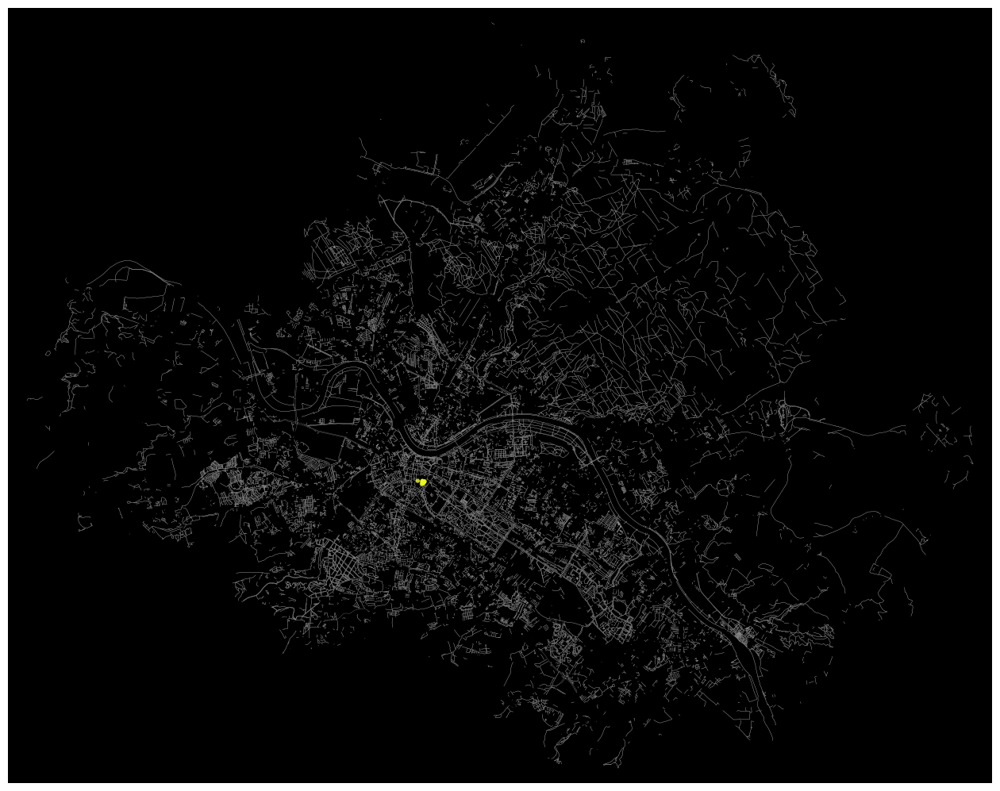

In [107]:
# color the nodes according to isochrone then plot the street network
node_colors = {}
for trip_time, color in zip(sorted(trip_times, reverse=True), iso_colors):
    subgraph = nx.ego_graph(H1, center_node, radius=trip_time, distance='time')
    for node in subgraph.nodes():
        node_colors[node] = color
nc = [node_colors[node] if node in node_colors else 'none' for node in H1.nodes()]
ns = [15 if node in node_colors else 0 for node in H1.nodes()]
fig
fig, ax = ox.plot_graph(H1, node_color=nc, node_size=ns, node_alpha=0.8, node_zorder=2,
                        bgcolor='k', edge_linewidth=0.2, edge_color='#999999', figsize=(16, 16))

## Medium

- Medium: Alles außer große Straßen

In [108]:
H1, H1_84 = prep_graph(place, szenarios[1], travel_speed)
# This is to big for Jupyter-book so please try it locally!
# isochrone_polys = make_iso_polys(H1, edge_buff=25, node_buff=0, infill=True)
# converted_isochrone_polys = [convert_coordinates(
#     polygon) for polygon in isochrone_polys]
# m = make_folium(H1_84, converted_isochrone_polys, iso_colors, center_point)
# m

Done Loading Graph...


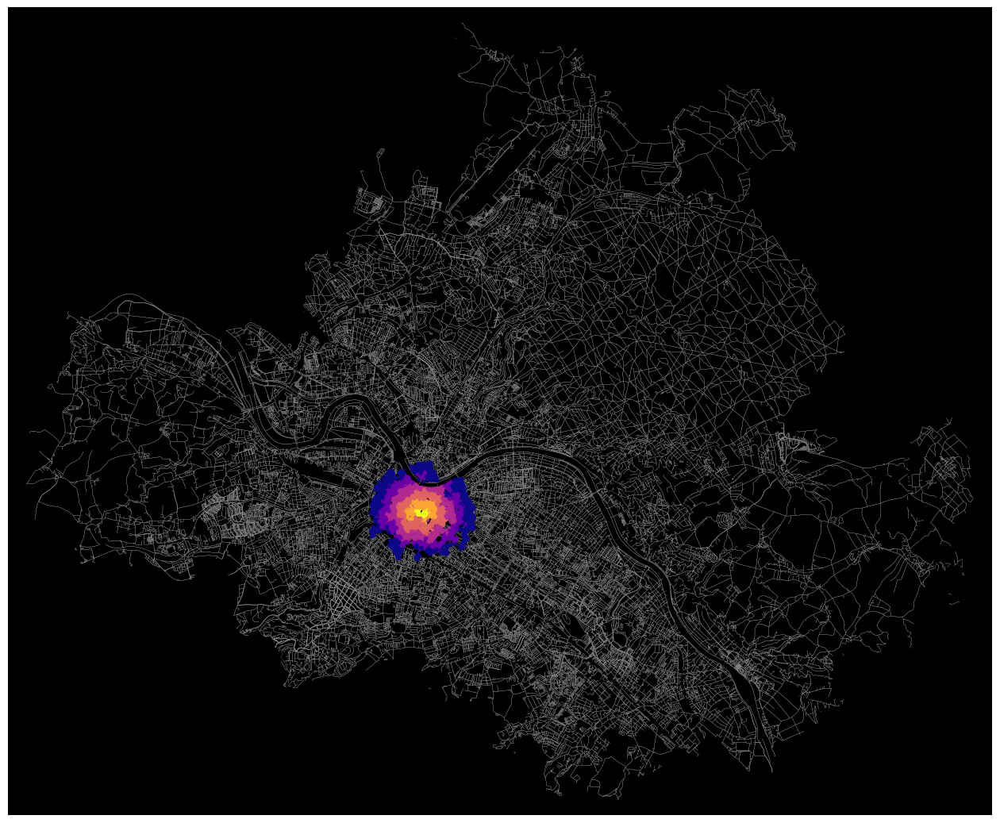

In [109]:
# color the nodes according to isochrone then plot the street network
node_colors = {}
for trip_time, color in zip(sorted(trip_times, reverse=True), iso_colors):
    subgraph = nx.ego_graph(H1, center_node, radius=trip_time, distance='time')
    for node in subgraph.nodes():
        node_colors[node] = color
nc = [node_colors[node] if node in node_colors else 'none' for node in H1.nodes()]
ns = [15 if node in node_colors else 0 for node in H1.nodes()]
fig
fig, ax = ox.plot_graph(H1, node_color=nc, node_size=ns, node_alpha=0.8, node_zorder=2,
                        bgcolor='k', edge_linewidth=0.2, edge_color='#999999', figsize=(16, 16))

## Medium-restricted

- Medium-restricted: Sidewalks und Radwege


In [110]:
H1, H1_84 = prep_graph(place, szenarios[2], travel_speed)
# This is to big for Jupyter-book so please try it locally!
# isochrone_polys = make_iso_polys(H1, edge_buff=25, node_buff=0, infill=True)
# converted_isochrone_polys = [convert_coordinates(
#     polygon) for polygon in isochrone_polys]
# m = make_folium(H1_84, converted_isochrone_polys, iso_colors, center_point)
# m

Done Loading Graph...


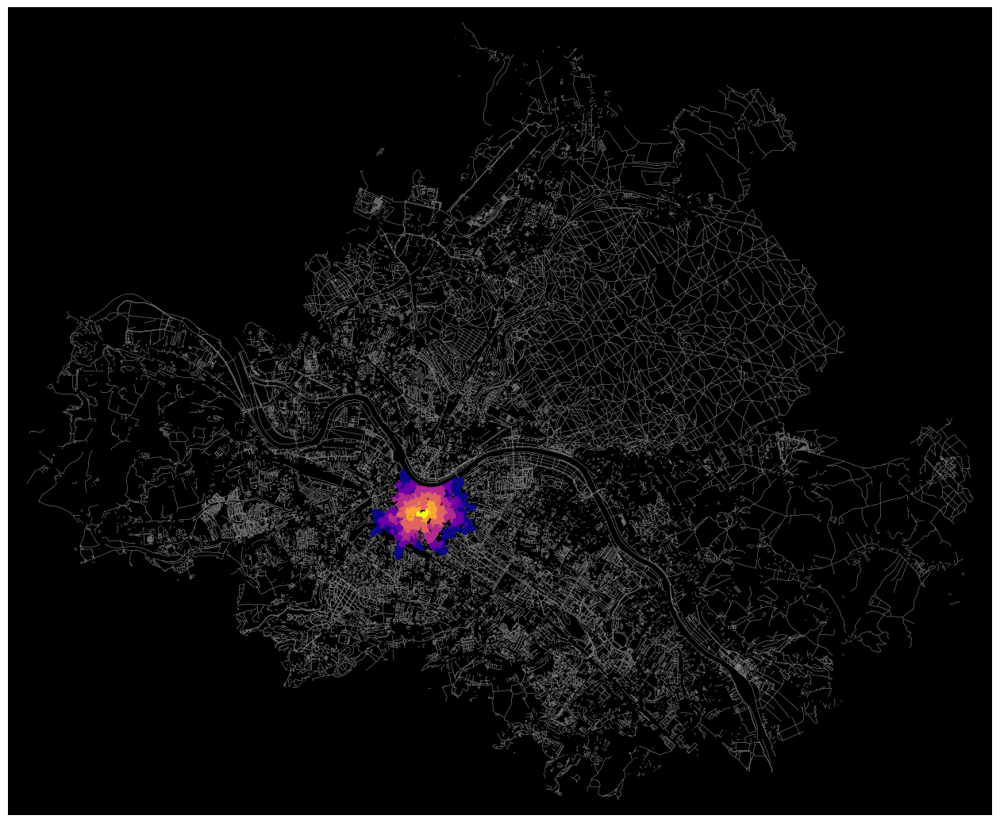

In [111]:
# color the nodes according to isochrone then plot the street network
node_colors = {}
for trip_time, color in zip(sorted(trip_times, reverse=True), iso_colors):
    subgraph = nx.ego_graph(H1, center_node, radius=trip_time, distance='time')
    for node in subgraph.nodes():
        node_colors[node] = color
nc = [node_colors[node] if node in node_colors else 'none' for node in H1.nodes()]
ns = [15 if node in node_colors else 0 for node in H1.nodes()]
fig
fig, ax = ox.plot_graph(H1, node_color=nc, node_size=ns, node_alpha=0.8, node_zorder=2,
                        bgcolor='k', edge_linewidth=0.2, edge_color='#999999', figsize=(16, 16))

## Large

- Large: Nur Straßen keine Fuß und Radwege

In [112]:
H1, H1_84 = prep_graph(place, szenarios[3], travel_speed)
# This is to big for Jupyter-book so please try it locally!
# isochrone_polys = make_iso_polys(H1, edge_buff=25, node_buff=0, infill=True)
# converted_isochrone_polys = [convert_coordinates(
#     polygon) for polygon in isochrone_polys]
# m = make_folium(H1_84, converted_isochrone_polys, iso_colors, center_point)
# m

Done Loading Graph...


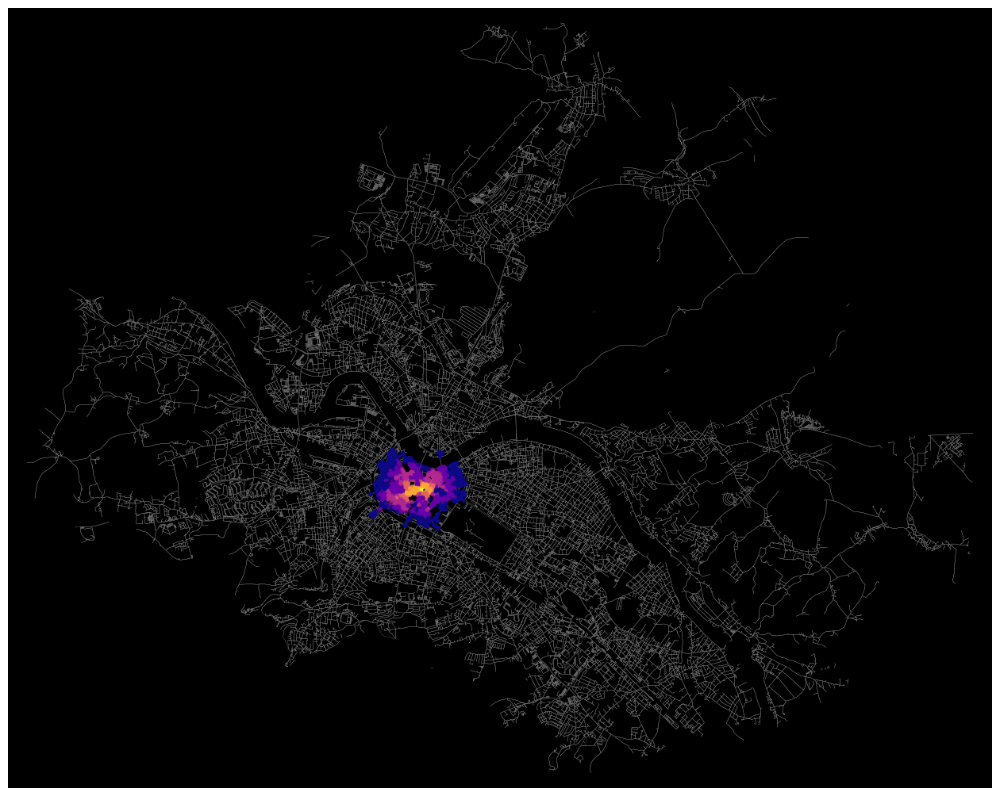

In [113]:
# color the nodes according to isochrone then plot the street network
node_colors = {}
for trip_time, color in zip(sorted(trip_times, reverse=True), iso_colors):
    subgraph = nx.ego_graph(H1, center_node, radius=trip_time, distance='time')
    for node in subgraph.nodes():
        node_colors[node] = color
nc = [node_colors[node] if node in node_colors else 'none' for node in H1.nodes()]
ns = [15 if node in node_colors else 0 for node in H1.nodes()]
fig
fig, ax = ox.plot_graph(H1, node_color=nc, node_size=ns, node_alpha=0.8, node_zorder=2,
                        bgcolor='k', edge_linewidth=0.2, edge_color='#999999', figsize=(16, 16))

## Optimal

- Optimal: Alles

Selbe wie [hier oben](faithful-isochrones-dresden)

In [114]:
# H5, H5_84 = prep_graph(place, szenarios[4], travel_speed)
# isochrone_polys = make_iso_polys(H5, edge_buff=25, node_buff=0, infill=True)
# converted_isochrone_polys = [convert_coordinates(
#     polygon) for polygon in isochrone_polys]
# m = make_folium(H_84, converted_isochrone_polys, iso_colors, center_point)
# m